# Kognitive Systeme - Lab 2

In dieser Laborübung geht es darum, das Prinzip des Q-Learnings an Hand eines praktischen Beispiels zu vertiefen. Als Grundlage dafür dient das Taxi-Problem aus OpenAI (https://gym.openai.com/). Das fertig erstellte, dokumentierte und lauffähige Notebook schicken Sie bis Donnerstag, 26.11.2020 (23:59:59 MEZ) an norbert.oswald@unibw.de

Ein autonom fahrendes Taxi sammelt einen Passagier an einem Startort ein
und fährt ihn zu seinem Zielort. Dafür sind folgende Aktivitäten erforderlich:
* Identifikation des Startortes, die Fahrt dorthin sowie das Einladen des Passagiers
* Identifikation des Zielortes, die Fahrt dorthin sowie das Ausladen des Passagiers

Beide Aktivitäten sollen schnellstmöglich durchgeführt werden. Die Simulationsumgebung liefert folgende Informationen:

* 25 mögliche Positionen für das Taxi
* ein Taxi ohne Passagier ist gelb/rot, sonst grün
* 4 mögliche fixe Start- oder Zielorte R,G,B oder Y
* konkreter Startort ist blau, Zielort ist pink
* 5 Positionen, an denen sich ein Passagier befinden kann

Für den Taxi-Agenten sollen 3 verschiedene Verhaltensweisen realisiert werden. In der ersten Aufgabe agiert der Taxi-Agent rein zufällig, in der zweiten Aufgabe basieren seine Entscheidungen auf dem Prinzip des Q-Learning und in der dritten Aufgabe verwendet der Agent das SARSA Lernverfahren. Für alle drei Aufgabe sind kleine Sourcecode-Fragemente vorgegeben. Ergänzen Sie diese an den angegebenen Stellen mit Ihrer Implementierung und überprüfen Sie das gewünschte Verhalten. Dokumentieren Sie für alle 3 Verfahren jeweils Ihre Vorgehensweise. 

In [1]:
import gym

# env = gym.make('Taxi-v3')
env = gym.make('Taxi-v3').env

## Aufgabe 1

Schreiben Sie eine Python-Anwendung für einen Taxiagenten, der seine Aktionen zufällig auswählt. Geben Sie an, welche Belohnung Sie erhalten und nach wievielen Schritten eine Lösung gefunden wurde.

In [2]:
def execute():
    print ("Ausführungsphase")
    #
    # An dieser Stelle soll Ihre Implementierung des 
    # zufällig agierenden Taxiagenten stehen  
    #

    env.reset()

    done = False    
    steps = 0
    score = 0

    while not done:

        # https://github.com/openai/gym/blob/master/gym/envs/toy_text/taxi.py

        # OBSERVATIONS:
        # 500 discrete states 
        # 25 taxi positions
        # 5 possible locations
        # 4 destination locations

        # ACTIONS:
        # move 0=south, 1=north, 2=east, 3=west, 4=pickup, 5=dropOff
  
        # choose random action
        action = env.action_space.sample()               
        # execute selected action
        _, reward, done, _ = env.step(action)

        steps += 1 
        score += reward

    print (f"steps: {steps}, score: {score}")

Testen Sie das Verhalten Ihrer Implementierung, indem Sie die nachfolgende Zelle ausführen. Mit *env.render()* wird der aktuelle Zustand visualisiert.

In [3]:
execute()
env.render()

Ausführungsphase
steps: 7989, score: -31503
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (Dropoff)


## Aufgabe 2

Das Verhalten des Taxi-Agenten soll nun so geändert werden, dass die von ihm vorgeschlagenenen Aktionen gemäß dem Q-Learning Algorithmus ermittelt wurden. 

Um Q-Learning anwenden zu können ist zunächst eine Lernphase notwendig. Ergänzen Sie zu diesem Zweck die nachfolgende Methode *learn()* in geeigneter Art und Weise. Die Übergabeparameter dürfen bei Bedarf angepasst werden.

In [4]:
import numpy
import random
import matplotlib.pyplot

In [5]:
def get_qtable():

    ###
    # CREATE Q-TABLE

    max_observations =  env.observation_space.n
    max_actions =  env.action_space.n

    print("max_observations:", max_observations)
    print("max_actions:", max_actions)

    qtable = numpy.zeros((max_observations, max_actions))

    print("qtable_shape:", qtable.shape)

    return qtable

In [6]:
def get_action(actions, epsilon):

    ###
    # EXPLORATION OR GREED

    # choose max index of action with propabilty 1-epsilon
    # otherwise choose random action
    if random.uniform(0, 1) > epsilon:
        action = numpy.argmax(actions)
    else:
        action = env.action_space.sample()

    return action

In [7]:

def learn(episodes: int = 10000):
    print ("Lernphase mit Q-Learning")
    #
    # An dieser Stelle soll Ihre Implementierung des 
    # Lernvorgangs für Q-Learning stehen  
    #

    # https://casey-barr.github.io/open-ai-taxi-problem/

    qtable = get_qtable()

    ###
    # HYPERPARAMETER

    alpha = 0.05    # learning rate
    gamma = 0.9     # discount factor

    ###
    # EXPLORATION

    # script v08-a s.29
    epsilon = 1             # exploration (or greedy)
    epsilon_min = 0.03      # min exploration
    epsilon_faktor = 0.5    # exploration faktor < 1
 
    ###
    # START Q-LEARNING

    steps_list = list()
    score_list = list()

    for episode in range(episodes):
        
        state = env.reset()

        done = False
        steps = 0
        score = 0

        while not done:

            action = get_action(qtable[state], epsilon)

            # execute selected action
            next_state, reward, done, _ = env.step(action)

            steps += 1
            score += reward

            ###
            # Q-LEARNING

            # script v08-a s.22
            old_value = qtable[state, action]            
            new_value = (1 - alpha) * old_value + alpha * (reward + gamma * numpy.max(qtable[next_state]))
            # replace old_value
            qtable[state, action] = new_value

            state = next_state

        # reduce epsilon (exploration) which leads to an increase in greed
        if (epsilon > epsilon_min):
            epsilon *= epsilon_faktor

        ###
        # DEBUG INFORMATION
        
        steps_list.append(steps)
        score_list.append(score)
    
        if(episode % 1000 == 0):
            print ("episode: {:6}, steps: {:6}, score: {:6}".format(
                episode, steps, score
            ))
    
    matplotlib.pyplot.figure(figsize=(20, 20))
    matplotlib.pyplot.plot(steps_list, ".", label="steps") 
    matplotlib.pyplot.plot(score_list, ".", label="score")
    matplotlib.pyplot.show()

    return qtable

Damit der Taxi-Agent von dem gelernten profitieren kann, ist eine entsprechende Ausführungsmethode zu programmieren. Ergänzen Sie zu diesem Zweck die nachfolgende Methode *execute()*. Die Übergabeparameter dürfen bei Bedarf angepasst werden. 

In [8]:
import statistics

In [9]:
def execute(qtable, rounds: int = 10, render: bool = True):
    print ("Ausführungsphase mit Q-Learning")
    #
    # An dieser Stelle soll Ihre Implementierung der 
    # Aktionsausführung des Taxi-Agenten gemäß Q-Learning stehen  
    # 

    steps_list = list()
    score_list = list()

    for round in range(rounds):
        
        state = env.reset()

        done = False
        steps = 0
        score = 0

        while not done:

            # choose best action index
            action = numpy.argmax(qtable[state])
            # execute selected action
            next_state, reward, done, _ = env.step(action)

            steps += 1
            score += reward
            
            state = next_state    

            # render environment
            if render and (round == 0):
                env.render()

        steps_list.append(steps)
        score_list.append(score)

    print ("average_steps: {:6}, average_score: {:6}".format(
        statistics.mean(steps_list), statistics.mean(score_list)
    ))

Testen Sie das Verhalten Ihrer Implementierung, indem Sie z.B. die nachfolgende Zelle ausführen. Geben Sie an, welche Belohnung Sie erhalten und nach wievielen Schritten eine Lösung gefunden wurde.

Lernphase mit Q-Learning
max_observations: 500
max_actions: 6
qtable_shape: (500, 6)
episode:      0, steps:   1234, score:  -4885
episode:   1000, steps:     57, score:    -45
episode:   2000, steps:     27, score:     -6
episode:   3000, steps:     10, score:     11
episode:   4000, steps:     18, score:      3
episode:   5000, steps:     12, score:      9
episode:   6000, steps:     13, score:      8
episode:   7000, steps:     15, score:      6
episode:   8000, steps:     12, score:      9
episode:   9000, steps:     15, score:     -3


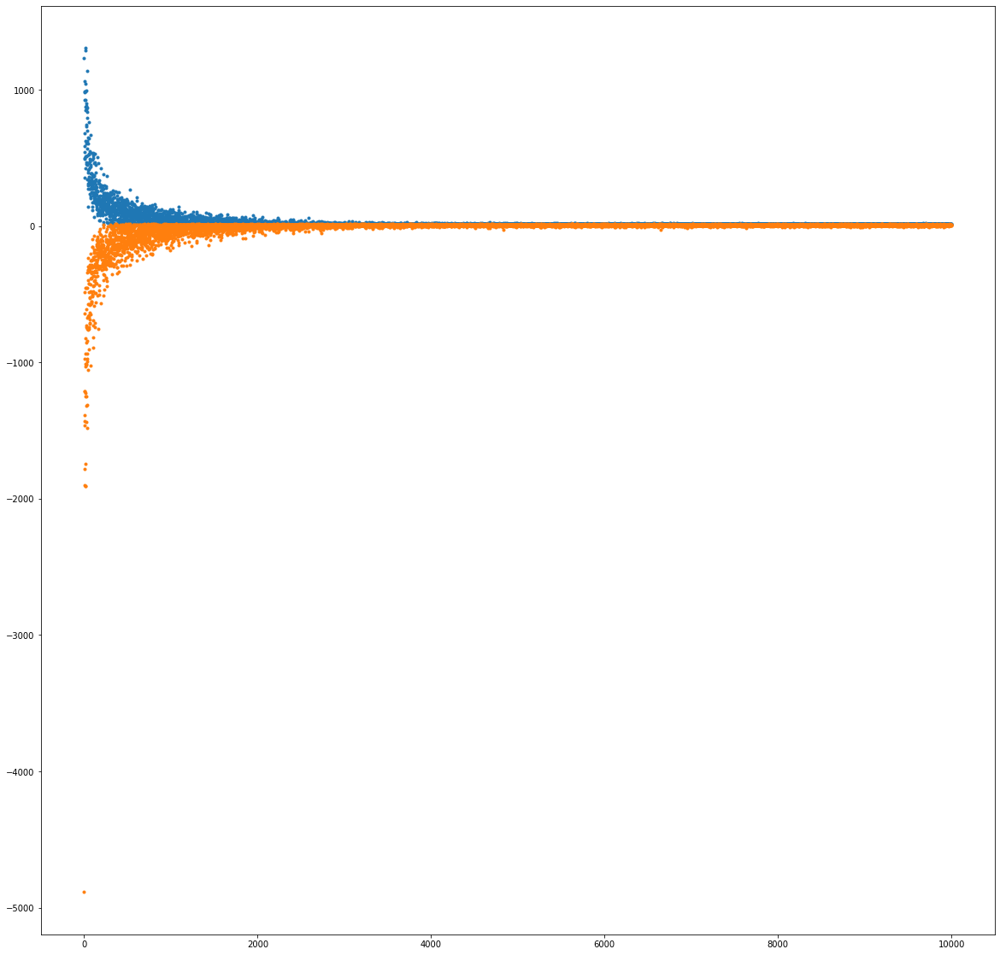

Ausführungsphase mit Q-Learning
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (West)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (West)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (West)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (Pickup)
+---------+
|R: | : :G|
|_: | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : | : : |
|_: : : : |
| | : | : |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : | 

In [10]:
qtable = learn()
execute(qtable)

In [11]:
raise Exception("SHORT BREAK!")

Exception: SHORT BREAK!

## Aufgabe 3

Nun soll das Verhalten des Taxi-Agenten mit dem SARSA Algorithmus implementiert werden. Vergleichen und Interpretieren Sie die Ergebnisse, die Sie mit Q-Learning und mit SARSA erhalten.


In [12]:
def learn(episodes: int = 100000):
    print ("Lernphase mit SARSA")
    #
    # An dieser Stelle soll Ihre Implementierung des 
    # Lernvorgangs für SARSA stehen  
    # 

    # https://casey-barr.github.io/open-ai-taxi-problem/

    qtable = get_qtable()

    ###
    # HYPERPARAMETER

    alpha = 0.005   # learning rate
    gamma = 0.9     # discount factor

    ###
    # EXPLORATION

    # script v08-a s.29
    epsilon = 1             # exploration (or greedy)
    epsilon_min = 0.03      # min exploration
    epsilon_faktor = 0.5    # exploration faktor < 1

    ###
    # START SARSA-LEARNING

    steps_list = list()
    score_list = list()

    for episode in range(episodes):
        
        state = env.reset()

        done = False
        steps = 0
        score = 0
        
        action = get_action(qtable[state], epsilon)

        while not done:

            # execute selected action
            next_state, reward, done, _ = env.step(action)

            steps += 1
            score += reward
            
            next_action = get_action(qtable[next_state], epsilon)

            ###
            # SARSA-LEARNING

            # script v08-a s.30
            old_value = qtable[state, action]
            new_value = (1 - alpha) * old_value + alpha * (reward + gamma * qtable[next_state, next_action])
            # replace old_value
            qtable[state, action] = new_value

            action = next_action
            state = next_state

        # reduce epsilon (exploration) which leads to an increase in greed
        if (epsilon > epsilon_min):
            epsilon *= epsilon_faktor

        ###
        # DEBUG INFORMATION
        
        steps_list.append(steps)
        score_list.append(score)

        if(episode % 10000 == 0):
            print ("episode: {:6}, steps: {:6}, score: {:6}".format(
                episode, steps, score
            ))
        
    matplotlib.pyplot.figure(figsize=(20, 20))
    matplotlib.pyplot.plot(steps_list, ".", label="steps") 
    matplotlib.pyplot.plot(score_list, ".", label="score")
    matplotlib.pyplot.show()

    return qtable

In [13]:
"""
def execute(qtable):
    print ("Ausführungsphase mit SARSA")
    #
    # An dieser Stelle soll Ihre Implementierung der 
    # Aktionsausführung des Taxi-Agenten gemäß SARSA stehen  
    # 
"""

'\ndef execute(qtable):\n    print ("Ausführungsphase mit SARSA")\n    #\n    # An dieser Stelle soll Ihre Implementierung der \n    # Aktionsausführung des Taxi-Agenten gemäß SARSA stehen  \n    # \n'

Lernphase mit SARSA
max_observations: 500
max_actions: 6
qtable_shape: (500, 6)
episode:      0, steps:   2020, score:  -7957
episode:  10000, steps:     27, score:     -6
episode:  20000, steps:     12, score:      9
episode:  30000, steps:     19, score:      2
episode:  40000, steps:     13, score:      8
episode:  50000, steps:     14, score:      7
episode:  60000, steps:     14, score:      7
episode:  70000, steps:     14, score:      7
episode:  80000, steps:     16, score:      5
episode:  90000, steps:     17, score:      4


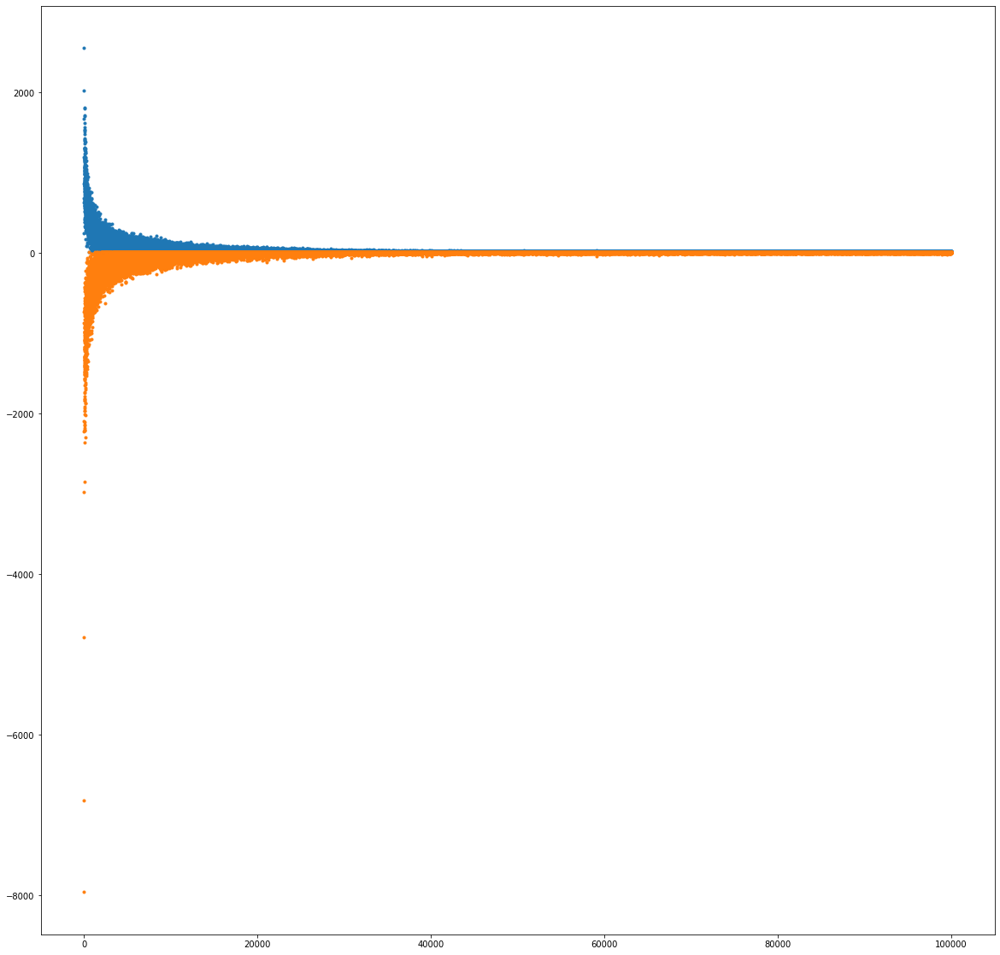

Ausführungsphase mit Q-Learning
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (North)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (Pickup)
+---------+
|R: | : :G|
| : | : :_|
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : | :_: |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (West)
+---------+
|R: | : :G|
| : | : : |
| : : :_: |
| | : | : |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : |_: |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+
  (South)
+---------+
|R: | : :G|
| : 

In [14]:
qtable = learn()
execute(qtable)